<a href="https://colab.research.google.com/github/Jeonguks/rokey_project_E2/blob/main/AI_01/Training_notebook/yolo5n_fixed_result.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

https://drive.google.com/file/d/1y0r1ES3krzQ5wf1ezLdRj7Vcn7JG4UlF/view?usp=sharing


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# drive.flush_and_unmount()

#yolov8 훈련하기 시작

dataset을 저장할 폴더를 만들고 그곳으로 들어갑니다

In [2]:
%mkdir dataset

In [3]:
!cp /content/drive/MyDrive/my_data.zip /content/

In [4]:
!unzip /content/my_data.zip -d dataset/

Archive:  /content/my_data.zip
   creating: dataset/my_data/
   creating: dataset/my_data/train/
   creating: dataset/my_data/train/images/
  inflating: dataset/my_data/train/images/car_img_244.jpg  
  inflating: dataset/my_data/train/images/car_img_15.jpg  
  inflating: dataset/my_data/train/images/car_img_164.jpg  
  inflating: dataset/my_data/train/images/car_img_165.jpg  
  inflating: dataset/my_data/train/images/car_img_225.jpg  
  inflating: dataset/my_data/train/images/car_img_169.jpg  
  inflating: dataset/my_data/train/images/car_img_114.jpg  
  inflating: dataset/my_data/train/images/car_img_199.jpg  
  inflating: dataset/my_data/train/images/car_img_247.jpg  
  inflating: dataset/my_data/train/images/car_img_264.jpg  
  inflating: dataset/my_data/train/images/car_img_135.jpg  
  inflating: dataset/my_data/train/images/car_img_131.jpg  
  inflating: dataset/my_data/train/images/car_img_139.jpg  
  inflating: dataset/my_data/train/images/car_img_211.jpg  
  inflating: dataset/

In [5]:
%cd dataset

/content/dataset


(704, 704, 3)


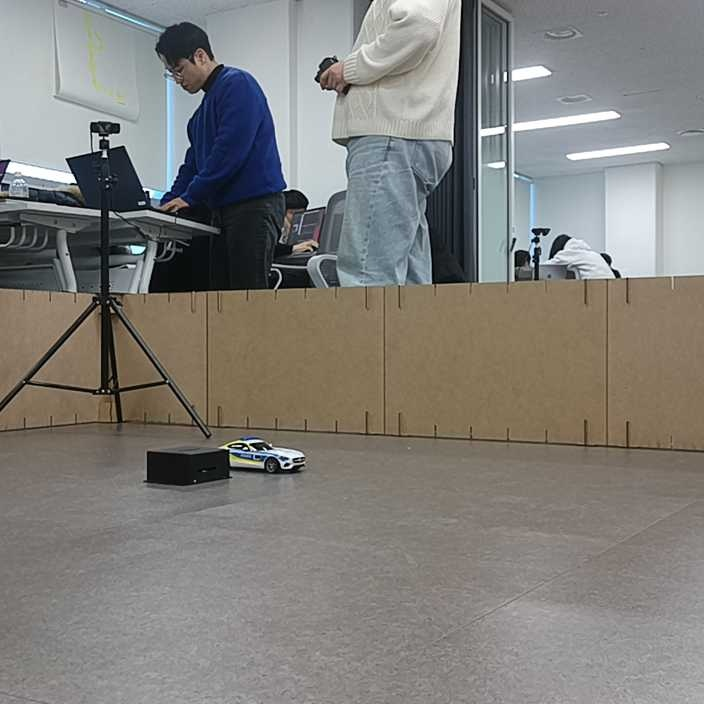

In [6]:
# Check if image all loarded ok
import glob
import cv2
from google.colab.patches import cv2_imshow
import random


# 이미지 파일 경로를 가져오기
image_paths = glob.glob('/content/dataset/my_data/test/images/*.jpg')

# 이미지가 없는 경우 에러 처리
if not image_paths:
    print("이미지 파일이 없습니다.")
else:
    # 랜덤하게 이미지 선택
    selected_image_path = random.choice(image_paths)

    # 이미지 표시
    img = cv2.imread(selected_image_path)
    print(img.shape)
    cv2_imshow(img)

해당경로에 이미지와 data.yaml이 나온것을 확인 할 수 있습니다

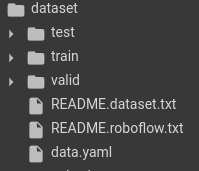

data.yaml을 확인합니다

In [7]:
#%cat data.yaml

새로운 yaml파일을 만들고 train, val, test 데이터셋 경로가 올바른게 작성해줘야 합니다



```
변경전                       변경후
train: ../train/images  ->  'train' : '/content/dataset/train/images'
```



In [8]:
import yaml

data = {
        'train' : '/content/dataset/my_data/train/images',
        'test' : '/content/dataset/my_data/test/images',
        'val' : '/content/dataset/my_data/valid/images',
        # 'train' : '/content/dataset/train/images',
        # 'test' : '/content/dataset/test/images',
        # 'val' : '/content/dataset/valid/images',

        'nc': 2,
        'names': ['car','dummy']
        # 'names': ['Truck','Dummy']
        # 'names': ['Normal','Error']
        # 'names' : ['NG', 'OK']
}

with open('/content/dataset/my_data/custom_data.yaml', 'w') as f:
# with open('/content/dataset/custom_data.yaml', 'w') as f:
  yaml.dump(data, f)

custom_data.yaml 파일을 만들었으니 제대로 작성이 되었는지 확인합니다

In [9]:
with open('/content/dataset/my_data/custom_data.yaml', 'r') as f:
# with open('/content/dataset/custom_data.yaml', 'r') as f:
  view_yaml = yaml.safe_load(f)
  display(view_yaml)


{'names': ['car', 'dummy'],
 'nc': 2,
 'test': '/content/dataset/my_data/test/images',
 'train': '/content/dataset/my_data/train/images',
 'val': '/content/dataset/my_data/valid/images'}

yolov8을 인스톨합니다

In [10]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 32.7 MB/s eta 0:00:00


yolov8이 제대로 설치가 되었는지 확인합니다

In [11]:
import ultralytics

ultralytics.checks()

Ultralytics 8.4.8 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA L4, 22693MiB)
Setup complete ✅ (12 CPUs, 53.0 GB RAM, 38.8/235.7 GB disk)


사전에 학습된 yolov8n.pt를 가져오고 적용시킵니다

yolov8의 학습파일은 yolov8n.pt, yolov8s.pt, yolov8m.pt, yolov8l.pt, yolov8x.pt 등이 있습니다

In [58]:
from ultralytics import YOLO

MODEL_NAME = 'yolov5n'

model = YOLO(f'{MODEL_NAME}.pt')

PRO TIP 💡 Replace 'model=yolov5n.pt' with new 'model=yolov5nu.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.



yolov8에서 사용하는 model이 yolov8n.pt 인지 확인해봅니다

yolov8은 cocodata의 분류를 가져서 80개의 name이 저장되어있습니다

In [59]:
print(type(model.names),len(model.names))

print(model.names)

<class 'dict'> 80
{0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboard', 67: 'cell p

우리가 원하는 데이터셋 경로를 가진 custom_data.yaml을 가지고 학습을 시작합니다

In [60]:
#results = model.predict('https://ultralytics.com/images/bus.jpg', save=True, show=True)

In [61]:
# from IPython.display import Image, clear_output
# Image(filename='/content/runs/detect/predict/bus.jpg',width=1000)

In [62]:

# model.train(data='/content/dataset/my_data/custom_data.yaml', epochs= 200, patience = 20, batch=32, imgsz =640,
# # model.train(data='/content/dataset/custom_data.yaml', epochs= 100, patience = 20, batch=32, imgsz =640,
#             # --- 데이터 증강 비활성화 (0.0으로 설정) ---
#     mosaic=0.7,          # 4장의 이미지를 합치는 증강 끔
#     mixup=0.1,           # 두 이미지를 섞는 증강 끔
#     hsv_h=0.015,          # 색상(Hue) 변화. 조명 색온도가 변하는 상황 대비.
#     hsv_s=0.7,            # 채도(Saturation) 변화. 조명 밝기 차이 극복.
#     hsv_v=0.4,            # 명도(Value) 변화. 그림자나 강한 조명(반사) 대응.
#     copy_paste=0.0,      # 객체를 복사해서 붙이는 증강 끔
#     degrees=10.0,         # 회전 끔
#     translate=0.1,       # 이동 끔
#     scale=0.5,           # 확대/축소 끔
#     shear=0.0,           # 전단(비틀기) 끔
#     perspective=0.0,     # 투영 변환 끔
#     flipud=0.0,          # 상하 반전 끔
#     fliplr=0.5,          # 좌우 반전

#     # --- 하이퍼파라미터 및 재현성 고정 ---
#     seed=42,             # 결과 재현을 위한 랜덤 시드 고정
#     deterministic=True,  # 결정론적 연산 사용 (속도는 약간 느려질 수 있음)
#     optimizer='SGD',     # 옵티마이저 고정 (예: 'Adam', 'SGD', 'AdamW')
#     lr0=0.01,            # 초기 학습률 고정
#             )

# results = model.train(
#     project="/content/my_results",
#     name=f"car_dummy_{MODEL_NAME}",
# )
results = model.train(
    data="/content/dataset/my_data/custom_data.yaml",
    epochs=200,
    patience=20,
    batch=32,
    imgsz=640,

    mosaic=0.7,
    mixup=0.1,
    hsv_h=0.015,
    hsv_s=0.7,
    hsv_v=0.4,
    copy_paste=0.0,
    degrees=10.0,
    translate=0.1,
    scale=0.5,
    shear=0.0,
    perspective=0.0,
    flipud=0.0,
    fliplr=0.5,

    seed=42,
    deterministic=True,
    optimizer="SGD",
    lr0=0.01,

    project="/content/my_results",
    name=f"car_dummy_{MODEL_NAME}",
    exist_ok=False,  # 같은 폴더 재사용
)

print("save_dir =", results.save_dir)


Ultralytics 8.4.8 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset/my_data/custom_data.yaml, degrees=10.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, end2end=None, epochs=200, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.1, mode=train, model=yolov5n.pt, momentum=0.937, mosaic=0.7, multi_scale=0.0, name=car_dummy_yolov5n, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, p

학습한 결과 분석은 다음경로에 새롭게 저장되었습니다

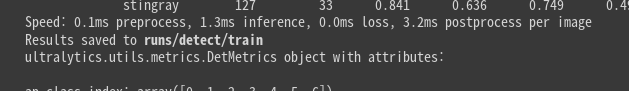

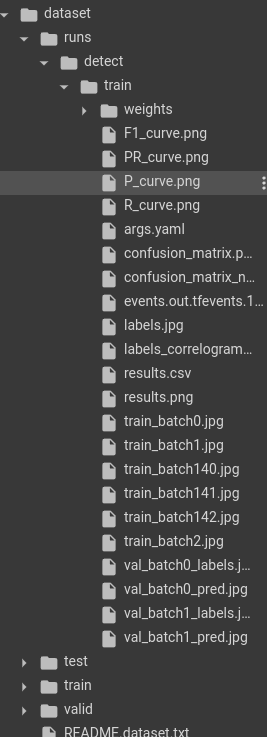

학습한 모델은 weights/best.pt 로 저장되어있습니다

yolov8은 학습하고 나서 자동적으로 모델을 변경합니다

실제로 변경되는지 확인합니다

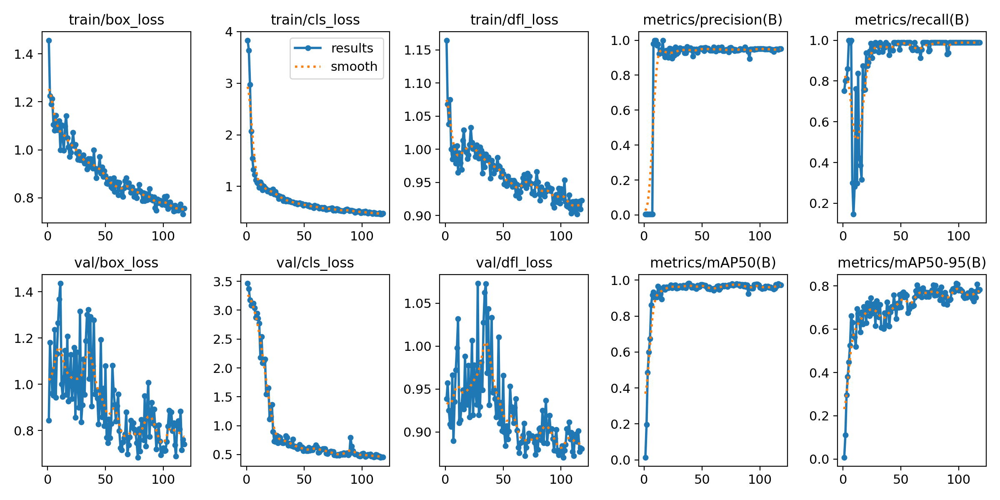

In [63]:
from IPython.display import Image, clear_output

save_dir = results.save_dir


Image(filename=f'{save_dir}/results.png',width=1000)

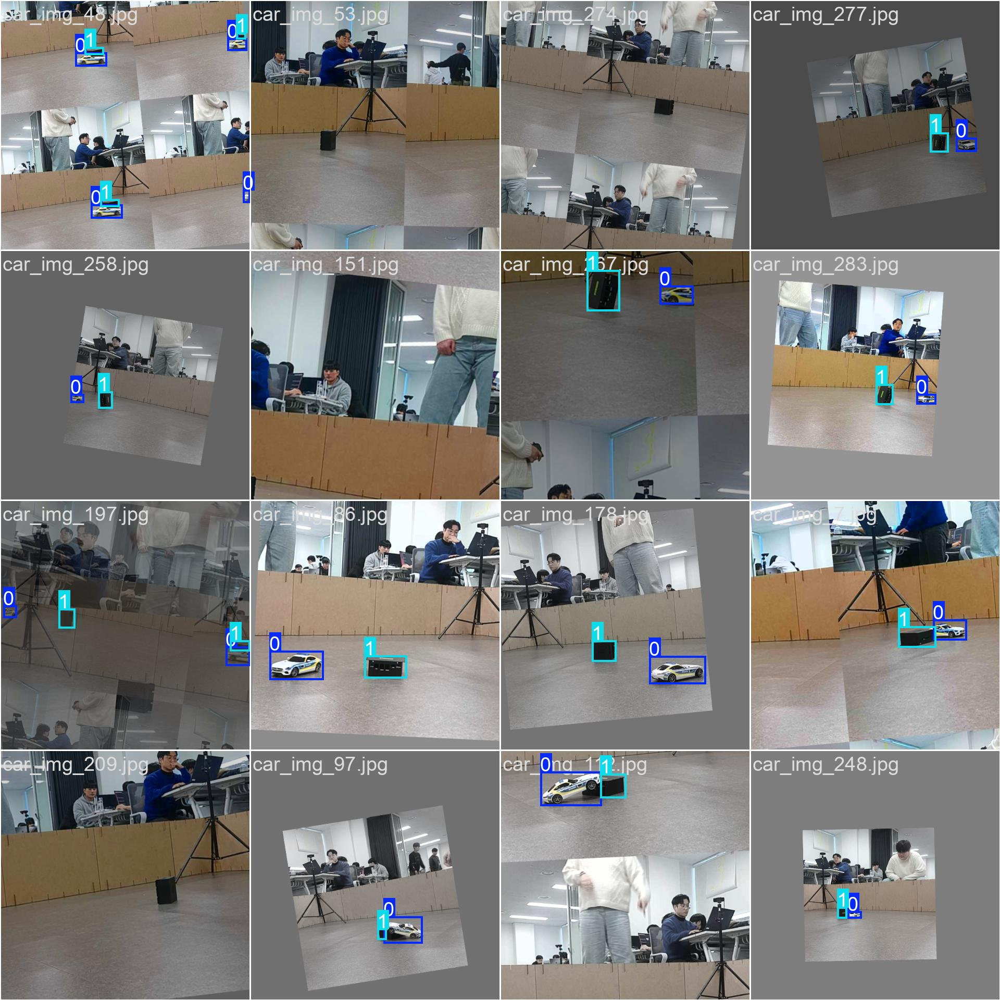

In [64]:
Image(filename=f'{save_dir}/train_batch0.jpg',width=1000)
# Image(filename='/content/runs/detect/train8/train_batch0.jpg',width=1000)

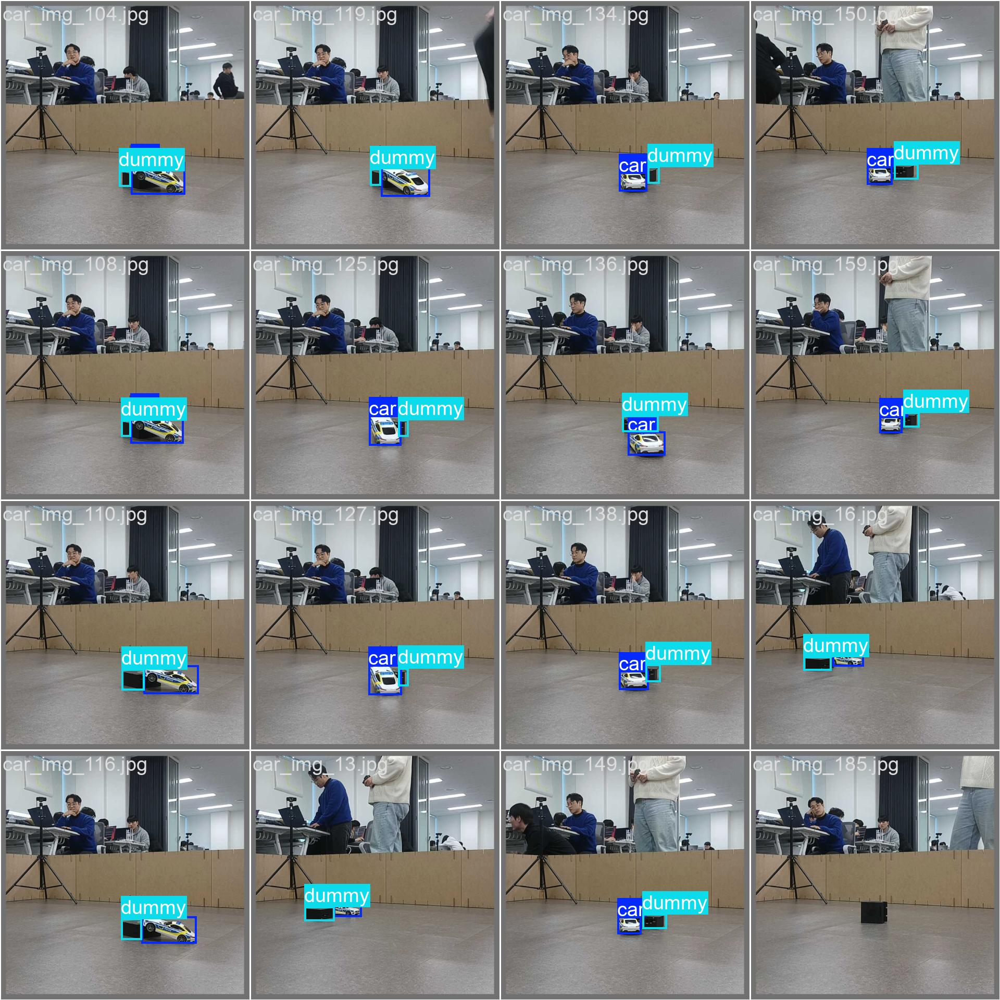

In [65]:
Image(filename=f'{save_dir}/val_batch0_labels.jpg',width=1000)

In [66]:
print(type(model.names),len(model.names))

print(model.names)

<class 'dict'> 2
{0: 'car', 1: 'dummy'}


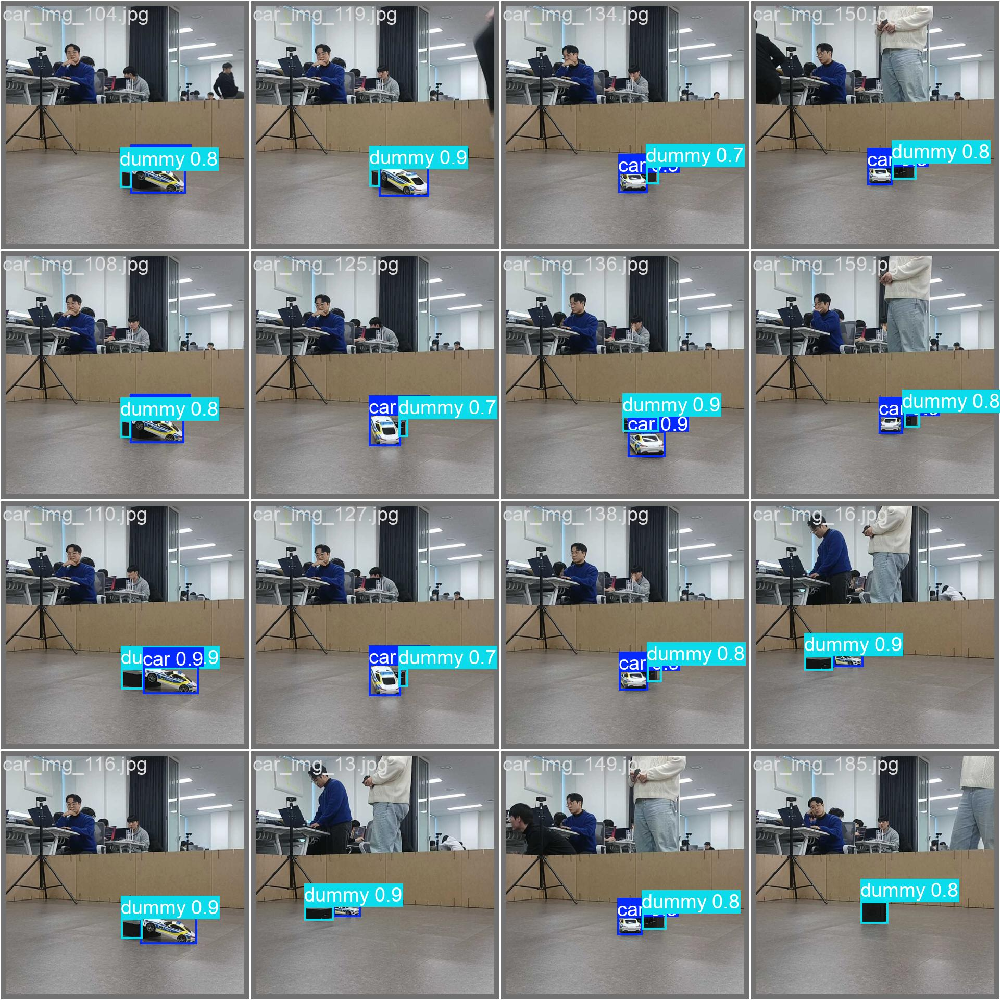

In [67]:
Image(filename=f'{save_dir}/val_batch0_pred.jpg',width=1000)

학습된 결과물을 출력하는 부분입니다

마지막 출력문인 'Results saved to '이후에 나오는 경로가 학습된 이미지 출력이 있는 폴더의 경로입니다

image.png

In [68]:
model = YOLO(f'{save_dir}/weights/best.pt')

In [69]:
print(type(model.names),len(model.names))

print(model.names)

<class 'dict'> 2
{0: 'car', 1: 'dummy'}


In [70]:
# 테스트 이미지

from glob import glob

test_image_list = glob('/content/dataset/test/images/*')

print(len(test_image_list))

test_image_list.sort()

for i in range(len(test_image_list)):

    print('i = ',i, test_image_list[i])

0


In [71]:
results = model.predict(source ='/content/dataset/my_data/test/images/', save=True)
# results = model.predict(source ='/content/dataset/test/images/', save=True)


image 1/30 /content/dataset/my_data/test/images/car_img_0.jpg: 640x640 2 cars, 1 dummy, 7.6ms
image 2/30 /content/dataset/my_data/test/images/car_img_103.jpg: 640x640 1 car, 1 dummy, 8.0ms
image 3/30 /content/dataset/my_data/test/images/car_img_11.jpg: 640x640 1 car, 1 dummy, 7.8ms
image 4/30 /content/dataset/my_data/test/images/car_img_118.jpg: 640x640 1 car, 1 dummy, 9.1ms
image 5/30 /content/dataset/my_data/test/images/car_img_120.jpg: 640x640 1 car, 1 dummy, 7.7ms
image 6/30 /content/dataset/my_data/test/images/car_img_130.jpg: 640x640 1 car, 1 dummy, 8.3ms
image 7/30 /content/dataset/my_data/test/images/car_img_132.jpg: 640x640 1 car, 1 dummy, 8.6ms
image 8/30 /content/dataset/my_data/test/images/car_img_133.jpg: 640x640 1 car, 1 dummy, 7.6ms
image 9/30 /content/dataset/my_data/test/images/car_img_140.jpg: 640x640 1 car, 1 dummy, 7.4ms
image 10/30 /content/dataset/my_data/test/images/car_img_153.jpg: 640x640 1 car, 1 dummy, 7.6ms
image 11/30 /content/dataset/my_data/test/images/c

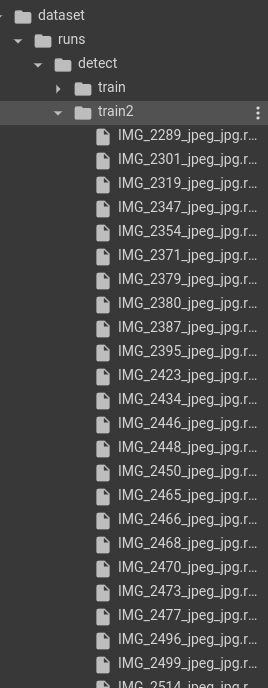

해당 경로에서 랜덤으로 이미지 출력을 보는 코드입니다

colab은 특수한 패키지를 사용해야 볼 수 있습니다

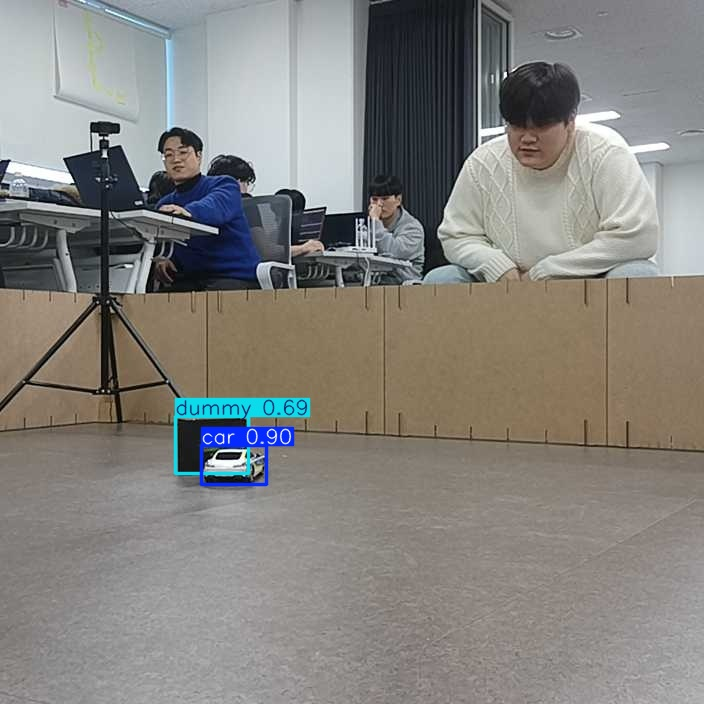

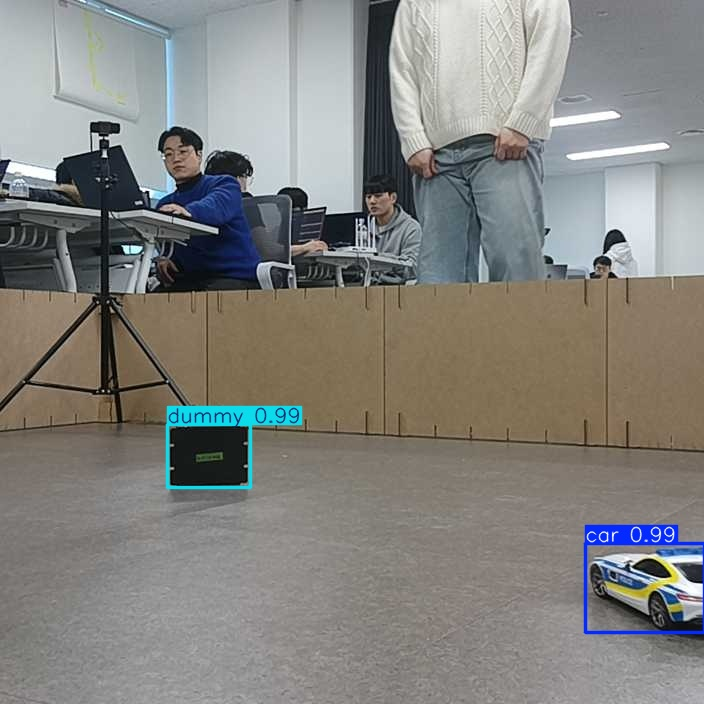

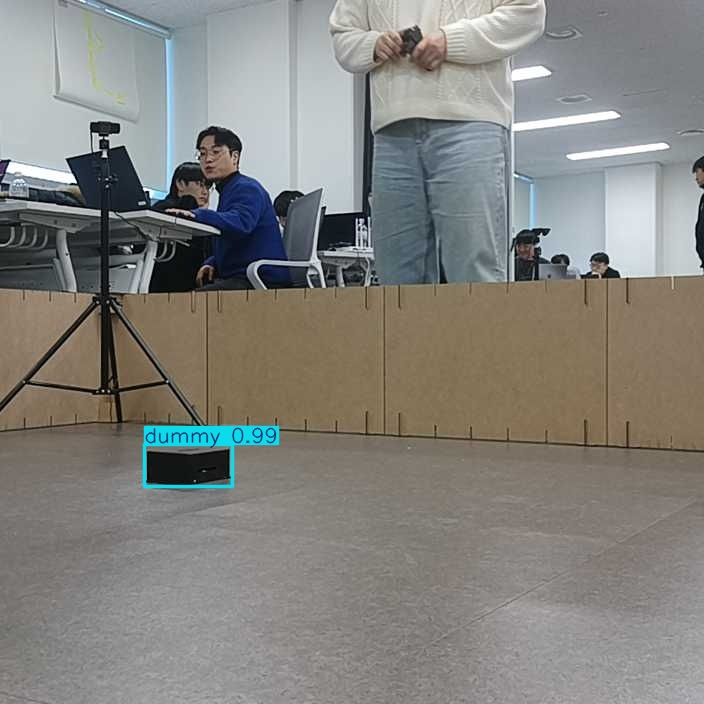

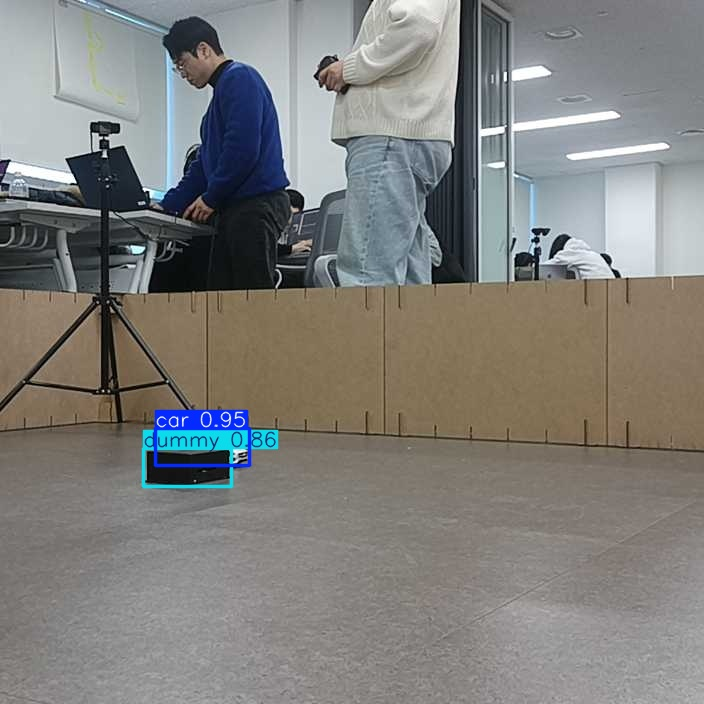

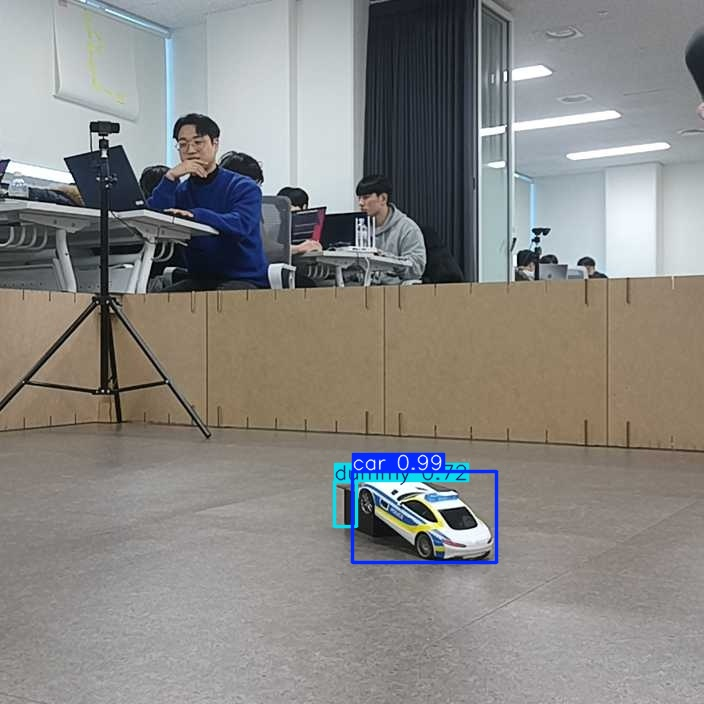

...

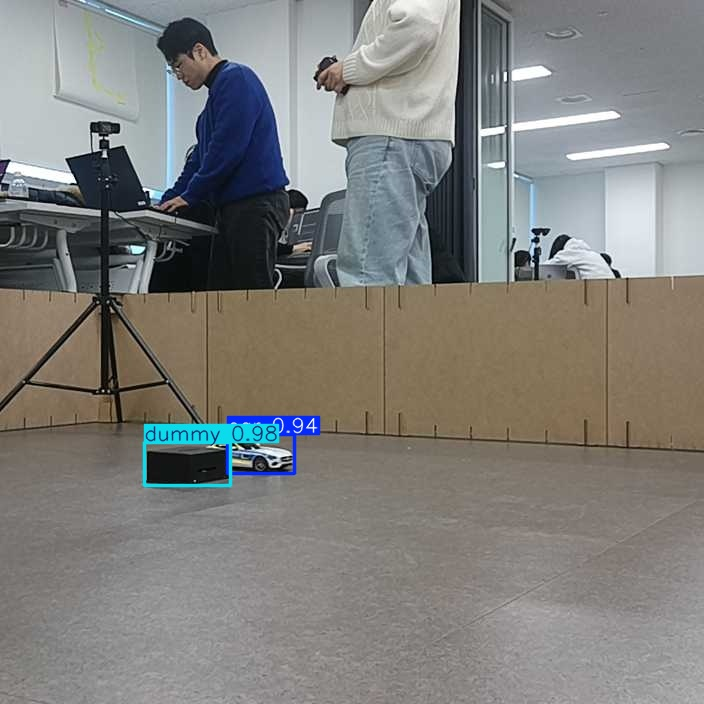

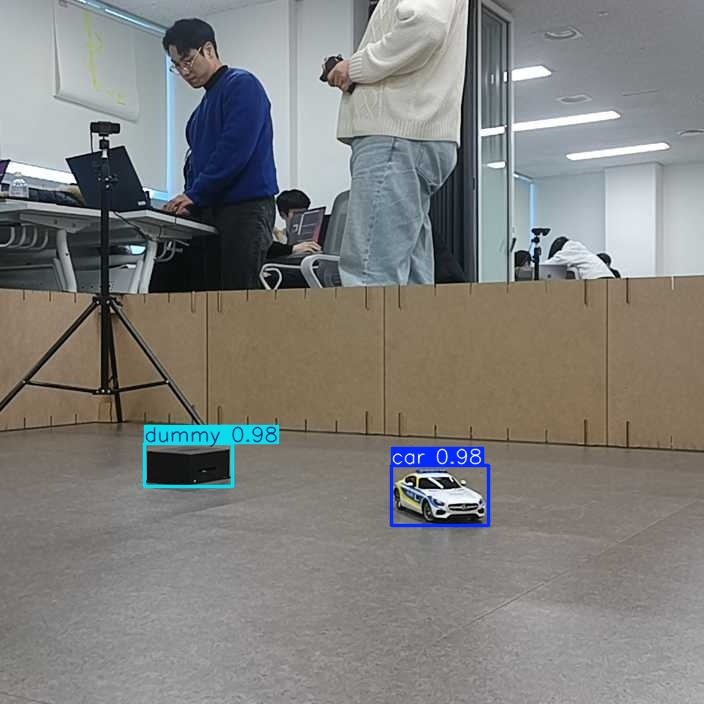

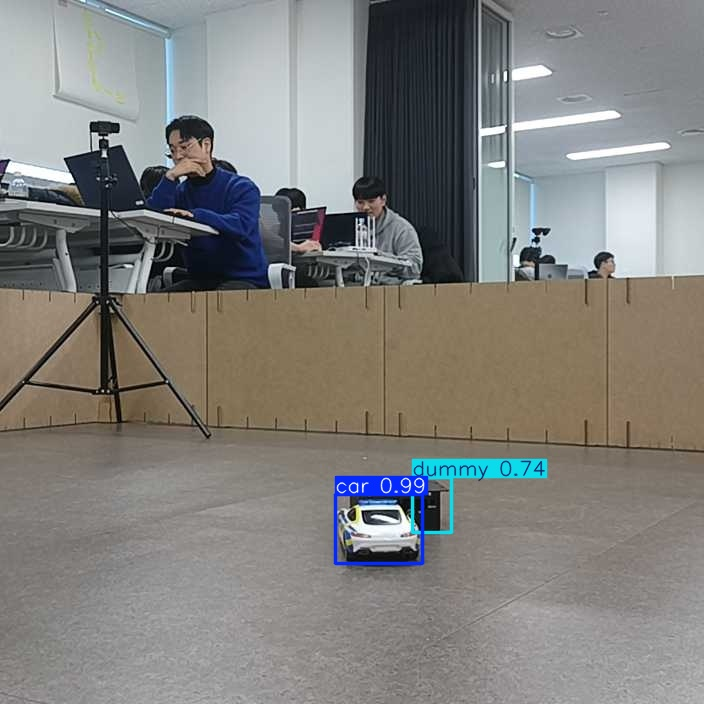

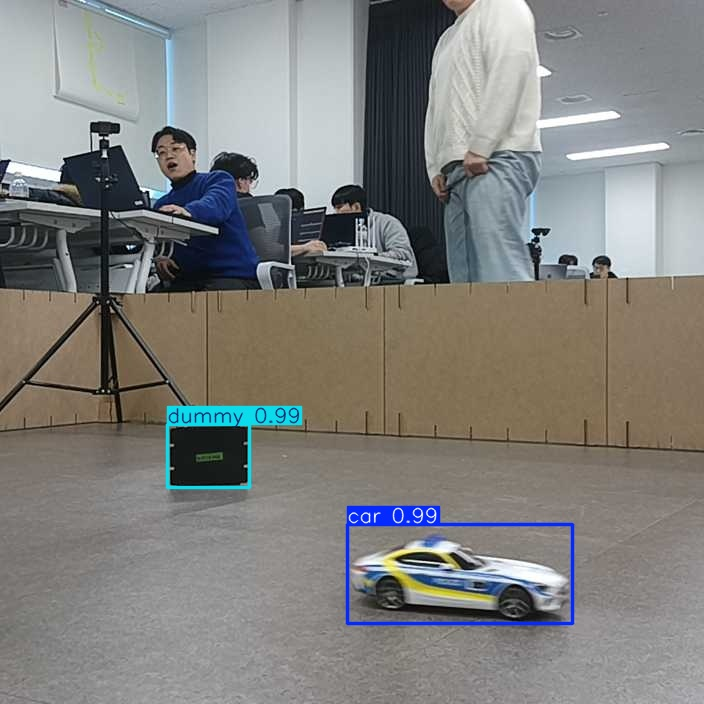

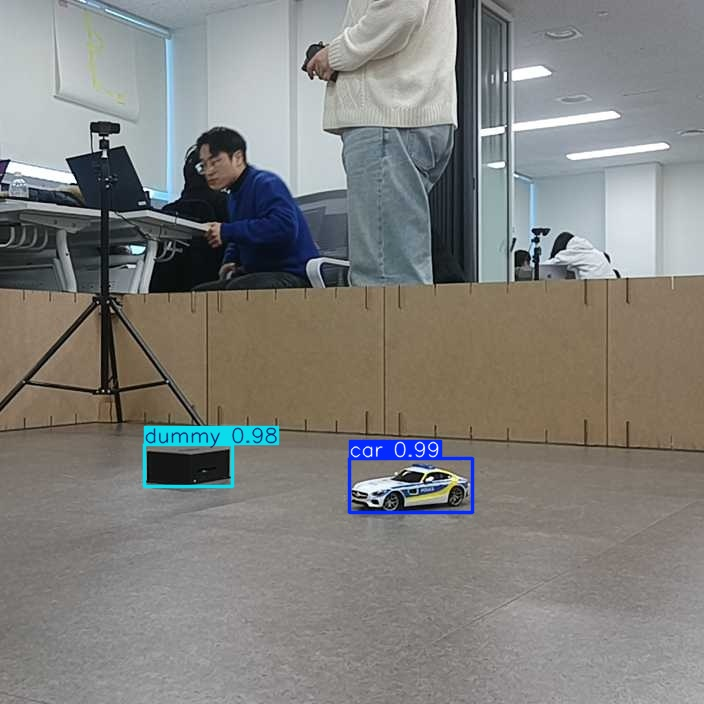

In [72]:
# 이미지 파일 경로를 가져오기
image_paths = glob('/content/dataset/runs/detect/predict/*.jpg')
# image_paths = glob('/content/runs/detect/predict2/*.jpg')

# 이미지가 없는 경우 에러 처리
if not image_paths:
    print("이미지 파일이 없습니다.")
else:
    # 랜덤하게 이미지 선택
    # selected_image_path = random.choice(image_paths)
    # 이미지 표시
    # img = cv2.imread(selected_image_path)

    for image_path in image_paths:
      img = cv2.imread(image_path)
      cv2_imshow(img)

만약 실제로 학습한 데이터를 자신의 드라이브에 저장하고 싶다면

In [73]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [74]:
# !cp /content/runs/detect/train/weights/best.pt /content/drive/MyDrive/My_Colab_Notebooks/Doosan
#!cp /content/runs/detect/train8/weights/best.pt /content/best_yolov10n
import os, shutil

dst = f"/content/best_{MODEL_NAME}.pt"
shutil.copy(f"{save_dir}/weights/best.pt", dst)

'/content/best_yolov5n.pt'

In [75]:
# ! cd /content
# ! zip -r runs.zip runs

In [76]:
# mv /content/runs.zip /content/drive/MyDrive/
